<center><img width=40% src="https://drive.google.com/uc?id=1zdyRP-8BEfguKqysftg_pcDX5SwakcDi&export=download"></center>

---
<a name=Section1  id=Section1></a>
# **1. Introduction**
---

1.    **There are various causes of earthquakes that include:**
       Tectonic movements
       Volcanic eruptions
       Meteor impacts
       Underground explosions
       Collapsing structures
2. Earthquakes happen when two large pieces of the Earth's crust suddenly slip. This causes shock waves to shake the surface of    the Earth in the form of an earthquake.

3. Where do earthquakes happen? 
   Most of the natural earthquakes are triggered by plate tectonics. Earthquakes usually occur on the edges of large sections of    the Earth's crust called tectonic plates.
   
4. The National Earthquake Information Centre (NEIC) files an average of 20,000 earthquakes every year around the world. The        edges, which are called fault lines, can get stuck, but the plates keep moving. Pressure slowly starts to build up where the    edges are stuck and, once the pressure gets strong enough, the plates will suddenly move causing an earthquake.

5. About 80 percent of the earthquakes of the planet occur along the rim of the Pacific Ocean, which is referred to as the "Ring    of Fire".

6. The largest earthquake ever recorded in the world was in Chile in 1960. It measured a 9.6 on the Richter Scale. The largest      in the US was a 9.2 magnitude in Alaska in 1964


- After reading about earthquakes, we came to realise that earthquakes are one of the major causes of destruction of life and     property and we wanted to use this project to get some valuable insights from the earthquakes data available from National       Earthquake Information Center(NEIC).  



<a name=Section2 id=Section2></a>
# **2. Problem Statement**
---

- This section is emphasised on providing some generic introduction to the problem that most companies confronts.

- **Problem Statement:**

    - Have the number of earthquakes increased over the years?
    - What is the distribution of Earthquakes across the globe?
    - How has this distribution of earthquakes changed over the years , starting 1965?
    - Is there any correlation between Earthquakes distribution and teconic plates distribution?
    - What is the distribution of earthquakes in India?
    


   

---
<a name=Section3 id=Section3></a>
# **3. Installing & Importing Libraries**
---

<a name=Section32 id=Section32></a>
### **3.2 Upgrading Libraries**

- **After upgrading** the libraries, you need to **restart the runtime** to make the libraries in sync. 

- Make sure not to execute the cell above (3.1) and below (3.2) again after restarting the runtime.

In [2]:
!pip install -q --upgrade pandas-profiling                           
# Upgrade pandas profiling package to the latest version

<a name=Section33 id=Section33></a>
### **3.3 Importing Libraries**

In [3]:
#-------------------------------------------------------------------------------------------------------------------------------
import pandas as pd                                                 # Importing package pandas (For Panel Data Analysis)
from pandas_profiling import ProfileReport                          # Import Pandas Profiling (To generate Univariate Analysis)
#-------------------------------------------------------------------------------------------------------------------------------
import numpy as np                                                  # Importing package numpys (For Numerical Python)
#-------------------------------------------------------------------------------------------------------------------------------
import matplotlib.pyplot as plt                                     # Importing pyplot interface to use matplotlib
import seaborn as sns                                               # Importing seaborn library for interactive visualization
%matplotlib inline
#-------------------------------------------------------------------------------------------------------------------------------

---
<a name=Section4 id=Section4></a>
# **4. Data Acquisition & Description**
---

- The data is a subset of the USGS dataset and its in-depth feature details can be found <a href="https://earthquake.usgs.gov/data/comcat/index.php#horizontalError">here</a>.


</br>

| Records | Features | Dataset Size |
| :-- | :-- | :-- |
| 23412 | 21 | 2.29 MB| 

</br>

| Id | Features | Description |
| :-- | :--| :--| 
|01|**Date**|Date at which the earthquake occurred.|
|02|**Time**|Time at which the earthquake occurred.|
|03|**Latitude**|Latitude of location of earthquake.|
|04|**Longitude**|Longitude of location of earthquake.|
|05|**Type**|Type of Disasters such as Earthquake, Nuclear Explosion, Explosion and Rock Burst. |
|06|**Depth**|Depth at which earthquake occurred (in km).|
|07|**Depth Error**| An earthquake cannot physically occur at a depth of 0 km or -1km however, sometimes due to misscalculation it is reported to be negetive. |
|08|**Depth Seismic Stations**| An earthquake can occur anywhere between the Earth's surface and about 700 kilometers below the surface. |
|09|**Magnitude**|Magnitude of earthquake on Richter scale.|
|10|**Magnitude Type**| The type of Earthquake Magnitude such as MW, MWC	MB etc.|
|11|**Magnitude Error**| The difference in between true magnitude and predicted magnitude is known as  Magnitude Error. | 
|12|**Magnitude Seismic Stations**| The existence of deep-focus earthquakes was confirmed in 1931 from studies of the seismograms of several earthquakes.|
|13|**Azimuthal Gap**| The maximum angle separating two adjacent seismic stations, both measured from the epicenter of an earthquake.|
|14|**Horizontal Distance**|Horizontal distance from the epicenter to the nearest station (in degrees). 1 degree is approximately 111.2 kilometers. |
|15|**Horizontal Error**|The horizontal location error, in km. |
|16|**Root Mean Square**| The frequently used measure of the differences between values (sample or population values) predicted by a model|
|||or an estimator and the values observed is known as Seismic Attribute|
|17|**ID**|Earthquake Identifier. |
|18|**Source**|The primary network contributors of the source of event. |
|19|**Location Source**|The network that originally authored the reported location of this event. |
|20|**Magnitude Source**|The network that originally authored the reported magnitude for this event. |
|21|**Status**|Indicates whether the event has been reviewed by a human. Contains: [Automatic, Reviewed]|

In [4]:
# making the pandas dataframe data from train.csv
data = pd.read_csv(filepath_or_buffer='https://raw.githubusercontent.com/insaid2018/Term-2/master/Data/earthquake.csv',parse_dates=[['Date', 'Time']])

# printing the shape of the data
print("Data Shape : ", data.shape)

# Calling the top 5 rows
data.head()

Data Shape :  (23412, 20)


,Date_Time,Latitude,Longitude,Type,Depth,Depth Error,Depth Seismic Stations,Magnitude,Magnitude Type,Magnitude Error,Magnitude Seismic Stations,Azimuthal Gap,Horizontal Distance,Horizontal Error,Root Mean Square,ID,Source,Location Source,Magnitude Source,Status
0,01/02/1965 13:44:18,19.246,145.616,Earthquake,131.6,NaN,NaN,6.0,MW,NaN,NaN,NaN,NaN,NaN,NaN,ISCGEM860706,ISCGEM,ISCGEM,ISCGEM,Automatic
1,01/04/1965 11:29:49,1.863,127.352,Earthquake,80.0,NaN,NaN,5.8,MW,NaN,NaN,NaN,NaN,NaN,NaN,ISCGEM860737,ISCGEM,ISCGEM,ISCGEM,Automatic
2,01/05/1965 18:05:58,-20.579,-173.972,Earthquake,20.0,NaN,NaN,6.2,MW,NaN,NaN,NaN,NaN,NaN,NaN,ISCGEM860762,ISCGEM,ISCGEM,ISCGEM,Automatic
3,01/08/1965 18:49:43,-59.076,-23.557,Earthquake,15.0,NaN,NaN,5.8,MW,NaN,NaN,NaN,NaN,NaN,NaN,ISCGEM860856,ISCGEM,ISCGEM,ISCGEM,Automatic
4,01/09/1965 13:32:50,11.938,126.427,Earthquake,15.0,NaN,NaN,5.8,MW,NaN,NaN,NaN,NaN,NaN,NaN,ISCGEM860890,ISCGEM,ISCGEM,ISCGEM,Automatic


<a name=Section41 id=Section41></a>
### **4.1 Data Description**

- In this section we will get **information about the data** and see some observations.

In [5]:
data.describe(include="all")

,Date_Time,Latitude,Longitude,Type,Depth,Depth Error,Depth Seismic Stations,Magnitude,Magnitude Type,Magnitude Error,Magnitude Seismic Stations,Azimuthal Gap,Horizontal Distance,Horizontal Error,Root Mean Square,ID,Source,Location Source,Magnitude Source,Status
count,23412,23412.000000,23412.000000,23412,23412.000000,4461.000000,7097.000000,23412.000000,23409,327.000000,2564.000000,7299.000000,1604.000000,1156.000000,17352.000000,23412,23412,23412,23412,23412
unique,23393,NaN,NaN,4,NaN,NaN,NaN,NaN,10,NaN,NaN,NaN,NaN,NaN,NaN,23412,13,48,24,2
top,07/03/1999 01:43:54,NaN,NaN,Earthquake,NaN,NaN,NaN,NaN,MW,NaN,NaN,NaN,NaN,NaN,NaN,USP0009CXU,US,US,US,Reviewed
freq,2,NaN,NaN,23232,NaN,NaN,NaN,NaN,7722,NaN,NaN,NaN,NaN,NaN,NaN,1,20630,20350,10458,20773
mean,NaN,1.679033,39.639961,NaN,70.767911,4.993115,275.364098,5.882531,NaN,0.071820,48.944618,44.163532,3.992660,7.662759,1.022784,NaN,NaN,NaN,NaN,NaN
std,NaN,30.113183,125.511959,NaN,122.651898,4.875184,162.141631,0.423066,NaN,0.051466,62.943106,32.141486,5.377262,10.430396,0.188545,NaN,NaN,NaN,NaN,NaN
min,NaN,-77.080000,-179.997000,NaN,-1.100000,0.000000,0.000000,5.500000,NaN,0.000000,0.000000,0.000000,0.004505,0.085000,0.000000,NaN,NaN,NaN,NaN,NaN
25%,NaN,-18.653000,-76.349750,NaN,14.522500,1.800000,146.000000,5.600000,NaN,0.046000,10.000000,24.100000,0.968750,5.300000,0.900000,NaN,NaN,NaN,NaN,NaN
50%,NaN,-3.568500,103.982000,NaN,33.000000,3.500000,255.000000,5.700000,NaN,0.059000,28.000000,36.000000,2.319500,6.700000,1.000000,NaN,NaN,NaN,NaN,NaN
75%,NaN,26.190750,145.026250,NaN,54.000000,6.300000,384.000000,6.000000,NaN,0.075500,66.000000,54.000000,4.724500,8.100000,1.130000,NaN,NaN,NaN,NaN,NaN


<a name=Section42 id=Section42></a>
### **4.2 Data Information**

- In this section we will see the **information about the types of features**.

In [6]:
data.info(verbose=True, memory_usage='deep', show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23412 entries, 0 to 23411
Data columns (total 20 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Date_Time                   23412 non-null  object 
 1   Latitude                    23412 non-null  float64
 2   Longitude                   23412 non-null  float64
 3   Type                        23412 non-null  object 
 4   Depth                       23412 non-null  float64
 5   Depth Error                 4461 non-null   float64
 6   Depth Seismic Stations      7097 non-null   float64
 7   Magnitude                   23412 non-null  float64
 8   Magnitude Type              23409 non-null  object 
 9   Magnitude Error             327 non-null    float64
 10  Magnitude Seismic Stations  2564 non-null   float64
 11  Azimuthal Gap               7299 non-null   float64
 12  Horizontal Distance         1604 non-null   float64
 13  Horizontal Error            115


 Columns - 'Depth Error', 'Magnitude Error', 'Magnitude Seismic Stations', 'Horizontal Distance', 'Azimuthal Gap', 'Horizontal Error', 'Depth Seismic Stations' have more missing data than available data.

<a name=Section5 id=Section5></a>

---
# **5. Data Pre-Profiling**
---

<a name=Section51 id=Section51></a>
### **5.1 Pre Profiling Report**

- For **quick analysis** pandas profiling is very handy.

- Generates profile reports from a pandas DataFrame.

- For each column **statistics** are presented in an interactive HTML report.

In [7]:
import  pandas_profiling
from pandas_profiling import ProfileReport
profile = ProfileReport(data)
profile.to_notebook_iframe()
print('Accomplished!')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Accomplished!


**Observations:**


1. Depth column has outliers but we know that earthquakes can occur at various depths, so not considering 'Depth' in Outlier analysis.
2. 4 Type of Disasters - Earthquake, Nuclear Explosion, Explosion and Rock Burst - considered but majority reults are of Earthquake.
3. Root Mean Square Column has no outliers as the mean and median are close



<a name=Section6 id=Section6></a>

---
# **6. Data Cleaning**
---

- This section is emphasised on performing data manipulation over unstructured data for further processing and analysis.

- To modify unstructured data to strucuted data you need to verify and manipulate the integrity of the data by:

  - Handling missing data,

  - Handling redundant data,

  - Handling inconsistent data,

  - Handling outliers,

  - Handling typos

**Handling missing data**

In [8]:
data['Date_Time'] = pd.to_datetime(data['Date_Time'],errors='coerce')

In [9]:
data['Date_Time'].loc[data['Date_Time'].isnull()]

3378    NaT
7512    NaT
20650   NaT
Name: Date_Time, dtype: datetime64[ns]

In [10]:
data.dropna(subset=['Date_Time'], inplace=True)

In [11]:
data = data[data.Type != 'Nuclear Explosion']
data = data[data.Type != 'Explosion']
data = data[data.Type != 'Rock Burst']

In [12]:
percent_missing = data.isnull().sum() * 100 /data.shape[0]
missing_value_df = pd.DataFrame({'column_name': data.columns,
                                 'percent_missing': percent_missing})

In [13]:
#Calculating percentage of missing data in each column
missing_value_df 

,column_name,percent_missing
Date_Time,Date_Time,0.000000
Latitude,Latitude,0.000000
Longitude,Longitude,0.000000
Type,Type,0.000000
Depth,Depth,0.000000
Depth Error,Depth Error,80.851522
Depth Seismic Stations,Depth Seismic Stations,69.507943
Magnitude,Magnitude,0.000000
Magnitude Type,Magnitude Type,0.012915
Magnitude Error,Magnitude Error,98.643936


<AxesSubplot:>

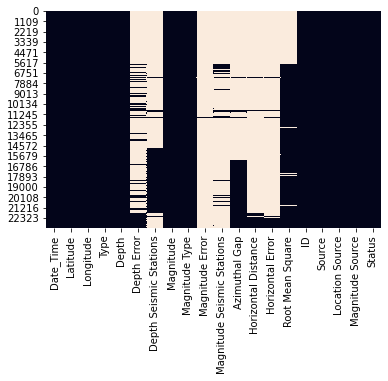

In [14]:
#missing data analysis using heatmap
sns.heatmap(data.isnull(), cbar=False)

In [15]:
#Removing columns with more than 50% data missing
data.drop(['Depth Error', 'Magnitude Error', 'Magnitude Seismic Stations', 'Horizontal Distance', 'Azimuthal Gap', 'Horizontal Error', 'Depth Seismic Stations'], axis=1, inplace=True)

In [16]:
data['Magnitude Type'].isnull().sum()

3

In [17]:
data.dropna(subset=['Magnitude Type'], inplace=True)

In [18]:
data['Magnitude Type'].isnull().sum()

0

In [19]:
data['Root Mean Square'].fillna(data['Root Mean Square'].mean(), inplace=True)

<AxesSubplot:>

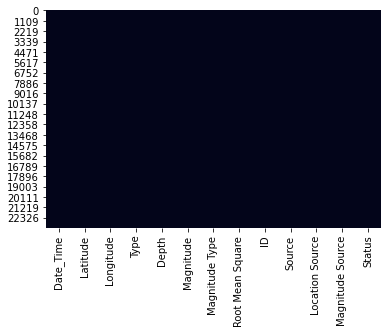

In [20]:
sns.heatmap(data.isnull(), cbar=False)

**Handling redundant data and inconsistencies.**

In [21]:
data.duplicated().value_counts()

False    23226
dtype: int64

In [22]:
data.duplicated(subset=['Date_Time']).value_counts() 

False    23207
True        19
dtype: int64

In [23]:
#To check if any two rows are not inconsistent with different magnitudes but with same date-time and location
data.duplicated(subset=['Date_Time', 'Latitude', 'Longitude']).value_counts()

False    23226
dtype: int64

**Handling Outliers**

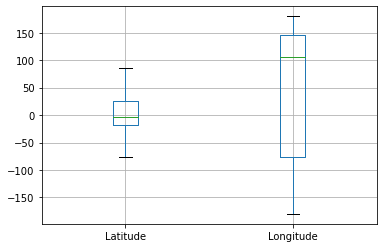

In [24]:
fig = data.boxplot(column=['Latitude', 'Longitude'])

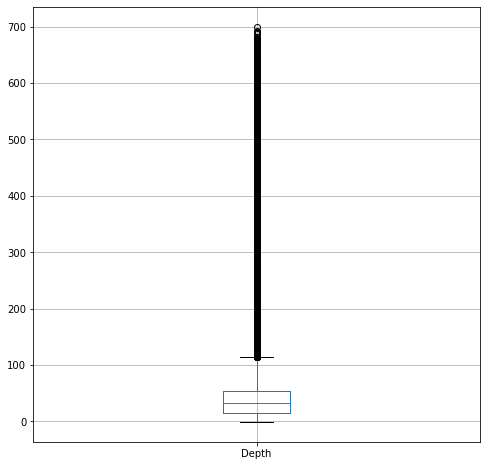

In [25]:
fig = data.boxplot(column=['Depth'], figsize=(8,8))

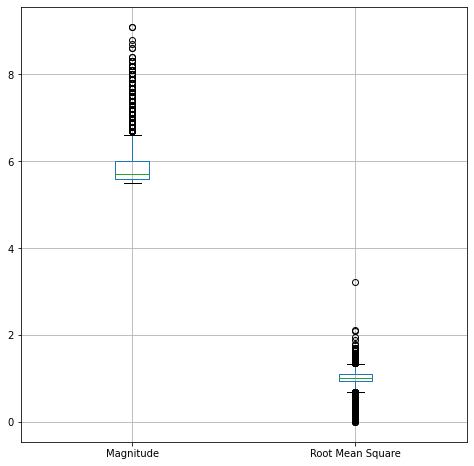

In [26]:
fig = data.boxplot(column=['Magnitude',  'Root Mean Square'], figsize=(8,8))

## <a name=Section8 id=Section8></a>

---
# **7. Exploratory Data Analysis**
---

- This section is emphasised on asking the right questions and perform analysis using the data.

- Note that there is no limit how deep you can go, but make sure not to get distracted from right track.

<a name=Section81 id=Section81></a>
<h4><strong>Question:<strong> What?, When?, Where?, What?, How?</h4>

In [27]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 23226 entries, 0 to 23411
Data columns (total 13 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   Date_Time         23226 non-null  datetime64[ns]
 1   Latitude          23226 non-null  float64       
 2   Longitude         23226 non-null  float64       
 3   Type              23226 non-null  object        
 4   Depth             23226 non-null  float64       
 5   Magnitude         23226 non-null  float64       
 6   Magnitude Type    23226 non-null  object        
 7   Root Mean Square  23226 non-null  float64       
 8   ID                23226 non-null  object        
 9   Source            23226 non-null  object        
 10  Location Source   23226 non-null  object        
 11  Magnitude Source  23226 non-null  object        
 12  Status            23226 non-null  object        
dtypes: datetime64[ns](1), float64(5), object(7)
memory usage: 2.5+ MB


**Question** - Is there any relation between Depth and Magnitude of Earthquake?

<AxesSubplot:xlabel='Depth'>

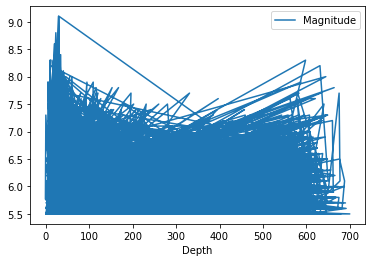

In [28]:
data.plot(x='Depth', y='Magnitude')

**Question** - Have the number of earthquakes increased over the years?

In [29]:
data['year'] = data['Date_Time'].dt.year

In [30]:
def f(x):
     return pd.Series(dict(Count_of_Disaster = x['Type'].count(),))

In [31]:
yearly_count = data.groupby(data.year).apply(f)
print (len(yearly_count))
yearly_count.head()

52


,Count_of_Disaster
year,
1965,339
1966,233
1967,255
1968,303
1969,322


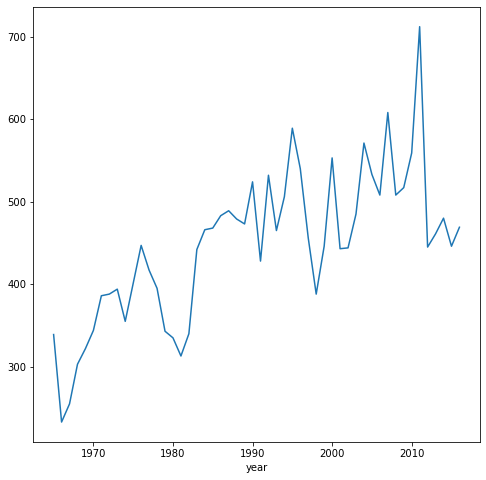

In [32]:
yearly_plot = yearly_count['Count_of_Disaster'].plot(figsize=(8,8))

**Question** - Is there any correlation between the columns?

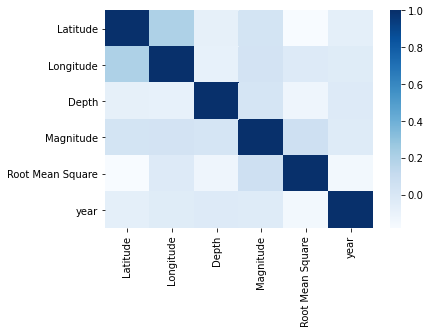

In [33]:
corr = data.corr()
hm = sns.heatmap(corr, cmap='Blues')
plt.show()

**Question** - What is the distribution of Earthquakes across the globe?

In [34]:
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio

In [35]:
fig = px.scatter_mapbox(data, lat="Latitude", lon="Longitude", color="Magnitude", 
                        mapbox_style="open-street-map", zoom = 0.5, color_continuous_scale = 'Reds')
fig.show()

**Question** - How has this distribution of earthquakes changed over the years , starting 1965? 

In [36]:
fig = px.scatter_mapbox(data, lat="Latitude", lon="Longitude", color="Magnitude", zoom = 0.5,
                        mapbox_style="open-street-map", color_continuous_scale = 'Reds', range_color = [5.0,10.0],
                       animation_frame = 'year')
fig.show()

**Question** - Is there any correlation between Earthquakes distribution and teconic plates distribution?

In [37]:
data1 = pd.read_csv(filepath_or_buffer='https://raw.githubusercontent.com/fraxen/tectonicplates/master/original/PB2002_steps.csv')
data1.head()

,SeqNum,PlateBoundIdentifer,PlateBoundContinuity,StartLong,StartLat,FinalLong,FinalLat,StepLength(km),AzimuthCenter,VelocityLeft,VelocityAzimuth,VelocityDivergent,VelocityRightLateral,Elevation,SeafloorAge,StepClass,StepContinuity,Orogen
0,1,AF-AN,False,-0.438,-54.852,-0.039,-54.677,32.1,53,13.2,48,1.2,13.1,-1584,2,OTF,False,False
1,2,AF-AN,True,-0.039,-54.677,0.443,-54.451,40.0,51,13.2,47,0.9,13.1,-1639,5,OTF,True,False
2,3,AF-AN,True,0.443,-54.451,0.965,-54.832,54.0,142,13.2,47,13.1,-1.1,-1687,4,OSR,False,False
3,4,AF-AN,True,0.965,-54.832,1.695,-54.399,67.3,44,13.2,46,-0.4,13.2,-4289,1,OTF,False,False
4,5,AF-AN,True,1.695,-54.399,2.360,-54.037,59.0,47,13.2,45,0.4,13.2,-4517,2,OTF,True,False


In [38]:
data1.columns

Index(['SeqNum', 'PlateBoundIdentifer', 'PlateBoundContinuity', 'StartLong',
       'StartLat', 'FinalLong', 'FinalLat', 'StepLength(km)', 'AzimuthCenter',
       'VelocityLeft', 'VelocityAzimuth', 'VelocityDivergent',
       'VelocityRightLateral', 'Elevation', 'SeafloorAge', 'StepClass',
       'StepContinuity', 'Orogen'],
      dtype='object')

In [39]:
data1.shape

(5819, 18)

In [40]:
data1.drop(['SeqNum', 'PlateBoundIdentifer', 'FinalLong', 'FinalLat', 'StepLength(km)', 'AzimuthCenter', 'VelocityLeft', 'VelocityAzimuth', 'VelocityDivergent', 'VelocityRightLateral', 'Elevation', 'SeafloorAge', 'StepClass', 'StepContinuity', 'Orogen'], axis=1, inplace=True)

In [41]:
data1.head()

,PlateBoundContinuity,StartLong,StartLat
0,False,-0.438,-54.852
1,True,-0.039,-54.677
2,True,0.443,-54.451
3,True,0.965,-54.832
4,True,1.695,-54.399


In [42]:
data1['Magnitude']=data['Magnitude']
# printing the shape of the data
print("Data Shape : ", data.shape)
data1.head()

Data Shape :  (23226, 14)


,PlateBoundContinuity,StartLong,StartLat,Magnitude
0,False,-0.438,-54.852,6.0
1,True,-0.039,-54.677,5.8
2,True,0.443,-54.451,6.2
3,True,0.965,-54.832,5.8
4,True,1.695,-54.399,5.8


In [43]:
fig = px.scatter_mapbox(data, lat="Latitude", lon="Longitude", color="Magnitude",
                        mapbox_style="open-street-map", zoom = 0.9, color_continuous_scale = px.colors.qualitative.Antique)


fig.add_trace(px.scatter_mapbox(data1, lat="StartLat", lon="StartLong",color_continuous_scale = 'aggrnyl',opacity=0.2).data[0])
fig.show()

**Question** - What is the distribution of earthquakes in India?

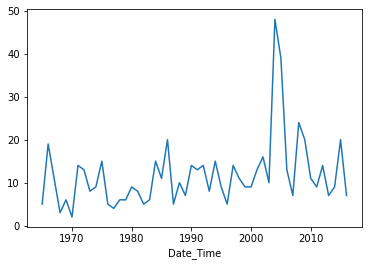

In [44]:
rdata = data[(data['Latitude'] > 8) & (data['Latitude']<38) & (data['Longitude'] > 68) & (data['Longitude'] < 98)]

rdata = rdata.set_index(['Date_Time'])

def f(x):
     return pd.Series(dict(Count_of_Disaster = x['Type'].count(),))



yearly_count = rdata.groupby(rdata.index.year).apply(f)
yearly_count.head()
yearly_plot = yearly_count['Count_of_Disaster'].plot()

In [45]:

from mpl_toolkits.basemap import Basemap
import matplotlib.pyplot as plt
m = Basemap(projection='mill',llcrnrlon=68.7,llcrnrlat=8.4,urcrnrlon=97.25,urcrnrlat=37.6,resolution='c'  )
longitudes =rdata["Longitude"].tolist()
latitudes = rdata["Latitude"].tolist()

x,y = m(longitudes,latitudes)
fig = plt.figure(figsize=(12,10))
plt.title("Map of India with areas effected by  earthquakes")
m.plot(x, y, "o", markersize = 3, color = 'red')
m.drawcoastlines()
m.fillcontinents(color='grey',lake_color='blue')
m.drawmapboundary()
m.drawcountries()
plt.show()

ModuleNotFoundError: No module named 'mpl_toolkits.basemap'

**Observations:**
1. There is no visible relation between Depth and Magnitude of Earthquakes.
2. Number of earthquakes have increased over the years.
3. We can clearly see the distribution of earthquakes on a global map based on the magnitude as well as over the years.
4. Can we with surity say that there is an overlap in location of tectonic plates and location of occurrence of earthquakes.
5. Most earthquakes in India occur in Himalayan region which overlay the Indo-Eurasian tectonic plate making this region a hotspot for earthquakes.

---
<a name=Section9 id=Section9></a>
# **9. Summarization**
---

<a name=Section91 id=Section91></a>
### **9.1 Conclusion**

- There is no correlation between depth and magnitude of an earthquake

- Most earthquakes occur near to major tectonic faults and boundaries in earth's crust.

- Some parts of the world like Japan are frequently affected by earthquakes as Japan lies on  highly seismically active zone famously called as ' The Pacific Ring of Fire '.

- Since most earthquakes occur in regions which are highly predictable , necessary arrrangements can be made to minimize the loss of life and property in such parts of the world .

<a name=Section92 id=Section92></a>
### **9.2 Actionable Insights*
- Regions lying on tectonic plate boundaries need to have fast and effective emergency response systems as there is high probability of major earthquakes occuring in regions like the Himalayas in South asia.


- The architechture of building in these regions need to designed with earthquake resistance in special focus.